<a href="https://colab.research.google.com/github/ma4ypic4y/license-plate-keypoint-detection/blob/main/key_point_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# License plate keypoint detection 🚗

In [2]:
!nvidia-smi

Wed Sep 14 21:57:35 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   46C    P8     9W /  70W |      0MiB / 15109MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [1]:
import os
import json
import random
import pandas as pd
import numpy as np
import cv2
from tqdm import tqdm
import itertools
from collections import defaultdict


import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from matplotlib.patches import Polygon
sns.set_style('whitegrid')


from sklearn.metrics import mean_squared_error

import torch
import torch.backends.cudnn as cudnn
import torch.nn as nn
import torch.optim
from torch.optim.lr_scheduler import ReduceLROnPlateau 
from torch.utils.data import Dataset, DataLoader


import torchvision
import torchvision.models as models
from torchvision.transforms import functional as F
from torchvision.models.detection.rpn import AnchorGenerator
from torchvision.io import read_image


import albumentations as A
from albumentations.pytorch import ToTensorV2

## Data preparation

In [ ]:
!curl -L "https://app.roboflow.com/ds/bLyMEPkPCh?key=Lqf6Ax0ASQ" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip

In [5]:
IMAGE_PATH = '/content/train'

In [6]:
df_col = ['src','left_up_x','left_up_y','right_up_x','right_up_y','left_down_x','left_down_y','right_down_x','right_down_y']
df = pd.DataFrame(columns=df_col)

markdown = json.load(open("/content/train/_annotations.coco.json"))

In [7]:
for  i,d in enumerate(markdown['annotations']):
  find_val = next((item for item in markdown['images'] if item["id"] == d['image_id']), None)
  if find_val and len(d['segmentation'][0])==10:
    df.loc[i]=[find_val["file_name"]]+d['segmentation'][0][:8]

In [8]:
mask = (df.iloc[:,1:] >=224).to_numpy()

In [9]:
df.loc[mask]

,src,left_up_x,left_up_y,right_up_x,right_up_y,left_down_x,left_down_y,right_down_x,right_down_y
775,Unknown_21182723814_bmp.rf.441d9baed0556510441...,224.0,48.379514,14.438173,50.132487,13.400088,113.407064,224.0,134.773774
775,Unknown_21182723814_bmp.rf.441d9baed0556510441...,224.0,48.379514,14.438173,50.132487,13.400088,113.407064,224.0,134.773774


In [10]:
df=df.drop([775])

In [11]:
class LicencePlatesDataset(Dataset):
    def __init__(self, df, img_dir, transform=None):
        self.img_labels = df
        self.img_dir = img_dir
        self.transform = transform

    def __len__(self):
        return len(self.img_labels)

    def __getitem__(self, idx):
        img_path = os.path.join(self.img_dir, self.img_labels.iloc[idx, 0])
        image = read_image(img_path)
        keys = self.img_labels.iloc[idx, 1:].values
        if self.transform:
          img_trans = self.transform(image = image.permute(1, 2, 0).numpy(), keypoints=keys.reshape(4,2))
          return img_trans['image'], torch.tensor(list(itertools.chain(*img_trans['keypoints'])))
          
        return image, torch.flatten(keys)


In [12]:
KEYPOINT_COLOR = (0, 255, 0) # Green

def vis_keypoints(image, keypoints, color=KEYPOINT_COLOR, diameter=2):
    image = image.copy()
    for (x, y) in keypoints:
        cv2.circle(image, (int(x), int(y)), diameter, (0, 255, 0), -1)
        
    plt.figure(figsize=(8, 8))
    plt.axis('off')
    plt.imshow(image)

## Define augmentation

In [13]:
train_transform = A.Compose([
        A.Resize(128,128),
        # A.OneOf([
        #     A.HueSaturationValue(p=0.5),
        #     A.RGBShift(p=0.7)
        # ], p=0.7),                          
        A.RandomBrightnessContrast(p=0.5),
        A.RGBShift(r_shift_limit=10, g_shift_limit=10, b_shift_limit=10, p=0.5),
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ],
    keypoint_params=A.KeypointParams(format='xy'),
)


val_transform = A.Compose([
        A.Resize(128,128),
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ],
    keypoint_params=A.KeypointParams(format='xy')
)


### Display augmentation

In [ ]:
n = 5
df_s = df.sample(n)
for i in range(n):
    image = cv2.imread(f'/content/train/{df_s.iloc[i,0]}')
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    vis_keypoints(image,np.array(df_s.iloc[i,1:]).reshape(4,2))
    for j in range(3):
        transformed = train_transform(image=image, keypoints=np.array(df_s.iloc[i,1:]).reshape(4,2))
        vis_keypoints(transformed['image'],transformed['keypoints'])

In [14]:
df.sample(5)

,src,left_up_x,left_up_y,right_up_x,right_up_y,left_down_x,left_down_y,right_down_x,right_down_y
405,12_6_2014_19_49_29_861_bmp.rf.2242ad8100d35ab5...,108.063575,151.409801,58.284446,167.575758,60.525154,186.157907,110.379082,166.511837
134,21_5_2014_17_38_59_95_bmp.rf.9e53af6c4d209c557...,144.001008,122.577778,97.345401,115.111111,98.045235,130.977778,143.767730,140.933333
557,Unknown_21195535519_bmp.rf.c83fa04a4a733cd1642...,146.100510,99.866667,72.617929,104.222222,72.384651,130.666667,145.167398,123.822222
853,21_5_2014_7_41_17_888_bmp.rf.5c72fdf47085d86f8...,107.143079,130.977778,77.317187,131.600000,76.816934,147.466667,105.743410,147.466667
511,21_5_2014_17_48_35_103_bmp.rf.bf0f28c705ea5328...,188.557112,132.533333,122.583854,115.733333,122.072873,135.955555,185.991054,151.822222


In [15]:
from sklearn.model_selection import train_test_split
train, test = train_test_split(df, test_size=0.2)

In [ ]:
from sklearn.model_selection import train_test_split
# split data by 3 sets
train, validate, test = \
              np.split(df.sample(frac=1, random_state=42), 
                       [int(.6*len(df)), int(.8*len(df))])
              

# X_train, X_test, y_train, y_test 
#     = train_test_split(X, y, test_size=0.2, random_state=1)

#  X_train, X_val, y_train, y_val 
#     = train_test_split(X_train, y_train, test_size=0.25, random_state=1) # 0.25 x 0.8 = 0.2

In [17]:
train_dataset = LicencePlatesDataset(train, IMAGE_PATH, train_transform)
val_dataset = LicencePlatesDataset(test, IMAGE_PATH, val_transform)

In [18]:
params = {
    "model": "resnet18",
    "device": "cuda", #cuda cpu
    "lr": float(0.001),
    "batch_size": 32,
    "num_workers": 4,
    "epochs": 50,
}

In [19]:
train_loader = DataLoader(train_dataset, 
                          batch_size=params['batch_size'],
                          shuffle=True)
valid_loader = DataLoader(val_dataset, 
                          batch_size=params['batch_size'], 
                          shuffle=False)

In [ ]:
# RESNET 18
model = getattr(models, params["model"])(weights=True, num_classes=1000,)

model.fc = nn.Sequential(
    nn.Linear(in_features=512, out_features=256),
    nn.ReLU(),
    nn.Linear(in_features=256, out_features=128),
    nn.ReLU(),
    nn.Dropout(p=0.25),
    nn.Linear(in_features=128, out_features=8)
)

# RESNET 18
model = getattr(models, params["model"])(weights=True, num_classes=1000,)

model.fc = nn.Sequential(
    nn.Linear(in_features=512, out_features=256),
    nn.Dropout(p=0.25),
    nn.Linear(in_features=256, out_features=8)
)

In [73]:
def flatten(t):
    t = t.reshape(1, -1)
    t = t.squeeze()
    return t

In [87]:
class Net(nn.Module):
    def __init__(self, numChannels, classes):
        # call the parent constructor
        super().__init__()
        # initialize first set of CONV => RELU => POOL layers
        self.conv1 = nn.Conv2d(in_channels=numChannels, out_channels=20,
            kernel_size=(5, 5))
        self.relu1 = nn.ReLU()
        self.maxpool1 = nn.MaxPool2d(kernel_size=(2, 2), stride=(2, 2))
        # initialize second set of CONV => RELU => POOL layers
        self.conv2 = nn.Conv2d(in_channels=20, out_channels=50,
            kernel_size=(5, 5))
        self.relu2 = nn.ReLU()
        self.maxpool2 = nn.MaxPool2d(kernel_size=(2, 2), stride=(2, 2))
        # initialize first (and only) set of FC => RELU layers
        self.fc1 = nn.Linear(in_features=42050, out_features=500)
        self.relu3 = nn.ReLU()
        # initialize our softmax classifier
        self.fc2 = nn.Linear(in_features=500, out_features=classes)
    def forward(self, x):
        # pass the input through our first set of CONV => RELU =>
        # POOL layers
        x = self.conv1(x)
        x = self.relu1(x)
        x = self.maxpool1(x)
        # pass the output from the previous layer through the second
        # set of CONV => RELU => POOL layers
        x = self.conv2(x)
        x = self.relu2(x)
        x = self.maxpool2(x)
        # flatten the output from the previous layer and pass it
        # through our only set of FC => RELU layers
        x = torch.flatten(x,1)
        x = self.fc1(x)
        x = self.relu3(x)
        # pass the output to our softmax classifier to get our output
        # predictions
        x = self.fc2(x)
        output = x
        # return the output predictions
        return output

In [20]:
class MetricMonitor:
    def __init__(self, float_precision=3):
        self.float_precision = float_precision
        self.reset()

    def reset(self):
        self.metrics = defaultdict(lambda: {"val": 0, "count": 0, "avg": 0})

    def update(self, metric_name, val):
        metric = self.metrics[metric_name]

        metric["val"] += val
        metric["count"] += 1
        metric["avg"] = metric["val"] / metric["count"]

    def __str__(self):
        return " | ".join(
            [
                "{metric_name}: {avg:.{float_precision}f}".format(
                    metric_name=metric_name, avg=metric["avg"], float_precision=self.float_precision
                )
                for (metric_name, metric) in self.metrics.items()
            ]
        )

In [21]:
def train(train_loader, model, criterion, optimizer, epoch, params):
    metric_monitor = MetricMonitor()
    model.train()
    stream = tqdm(train_loader)
    for i, (images, target) in enumerate(stream, start=1):
        images = images.to(params["device"], non_blocking=True)
        target = target.to(params["device"], non_blocking=True).float().view(-1, 8)
        output = model(images)
        loss = criterion(output, target)
        # mse = mean_squared_error(output.cpu().data.numpy(), target.cpu().data.numpy())
        metric_monitor.update("Loss", loss.item())
        metric_monitor.update("MSE", loss.item())
        
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()
        stream.set_description(
            "Epoch: {epoch}. Train.      {metric_monitor}".format(epoch=epoch, metric_monitor=metric_monitor)
        )
    
    model_info['metrics']['train'].append(float(metric_monitor.metrics['MSE']['avg']))
    model_info['loss']['train'].append(metric_monitor.metrics['Loss']['avg'])
    model_info['lr'].append(optimizer.param_groups[0]['lr'])

In [22]:
def validate(val_loader, model, criterion, epoch, params):
    metric_monitor = MetricMonitor()
    model.eval()
    stream = tqdm(val_loader)
    loss=0
    with torch.no_grad():
        for i, (images, target) in enumerate(stream, start=1):
            images = images.to(params["device"], non_blocking=True)
            target = target.to(params["device"], non_blocking=True).float().view(-1, 8)
            output = model(images)
            loss = criterion(output, target)
            # mse = mean_squared_error(output.cpu().data.numpy(), target.cpu().data.numpy())

            metric_monitor.update("Loss", loss.item())
            metric_monitor.update("MSE", loss.item())
            # loss_stats['val'].append(loss.item()/len(val_loader))
            stream.set_description(
                "Epoch: {epoch}. Validation. {metric_monitor}".format(epoch=epoch, metric_monitor=metric_monitor)
            )
    model_info['metrics']['val'].append(float(metric_monitor.metrics['MSE']['avg']))
    model_info['loss']['val'].append(metric_monitor.metrics['Loss']['avg'])
    return loss

In [23]:
def init_params(params):
    model = getattr(models, params["model"])(pretrained=False, num_classes=8,)
    model = model.to(params["device"])
    criterion = nn.CrossEntropyLoss().to(params["device"])
    optimizer = torch.optim.Adam(model.parameters(), lr=params["lr"])

    return model, criterion, optimizer

In [89]:
models_list = ['resnet18','resnet34','resnet50','resnet101','densenet121','mobilenet_v2']

params = {
    "model": 'resnet18',
    "device": "cuda",
    "lr": 0.01,
    "batch_size": 16,
    "num_workers": 2,
    "epochs": 20,
}

In [91]:
model = Net(3,8)
model = model.to(params["device"])
criterion = nn.CrossEntropyLoss().to(params["device"])
optimizer = torch.optim.Adam(model.parameters(), lr=params["lr"])

model_name="Net"
out_info = {}
scheduler = ReduceLROnPlateau(optimizer, 'min')
model_info = {}
model_info['model'] = model_name
model_info['metrics'] = {'train': [], 'val': [] }
model_info['loss'] = {'train': [], 'val': [] }
model_info['lr'] = []
for epoch in range(1, params["epochs"] + 1):
    print(optimizer.param_groups[0]['lr'])
    train(train_loader, model, criterion, optimizer, epoch, params)
    val_loss=validate(valid_loader, model, criterion, epoch, params)
    scheduler.step(val_loss)
    
out_info[model_name] = model_info




0.01


Epoch: 1. Train.      Loss: 16397.930 | MSE: 16397.930: 100%|██████████| 25/25 [00:01<00:00, 13.18it/s]
Epoch: 1. Validation. Loss: 1018.641 | MSE: 1018.641: 100%|██████████| 7/7 [00:00<00:00, 16.74it/s]


0.01


Epoch: 2. Train.      Loss: 1032.772 | MSE: 1032.772: 100%|██████████| 25/25 [00:01<00:00, 13.18it/s]
Epoch: 2. Validation. Loss: 1018.167 | MSE: 1018.167: 100%|██████████| 7/7 [00:00<00:00, 16.72it/s]


0.01


Epoch: 3. Train.      Loss: 1032.480 | MSE: 1032.480: 100%|██████████| 25/25 [00:01<00:00, 12.95it/s]
Epoch: 3. Validation. Loss: 1018.117 | MSE: 1018.117: 100%|██████████| 7/7 [00:00<00:00, 16.90it/s]


0.01


Epoch: 4. Train.      Loss: 1032.568 | MSE: 1032.568: 100%|██████████| 25/25 [00:01<00:00, 13.14it/s]
Epoch: 4. Validation. Loss: 1018.168 | MSE: 1018.168: 100%|██████████| 7/7 [00:00<00:00, 16.92it/s]


0.01


Epoch: 5. Train.      Loss: 1032.561 | MSE: 1032.561: 100%|██████████| 25/25 [00:01<00:00, 13.10it/s]
Epoch: 5. Validation. Loss: 1018.136 | MSE: 1018.136: 100%|██████████| 7/7 [00:00<00:00, 16.60it/s]


0.01


Epoch: 6. Train.      Loss: 1032.463 | MSE: 1032.463: 100%|██████████| 25/25 [00:01<00:00, 13.46it/s]
Epoch: 6. Validation. Loss: 1018.269 | MSE: 1018.269: 100%|██████████| 7/7 [00:00<00:00, 16.65it/s]


0.01


Epoch: 7. Train.      Loss: 1032.468 | MSE: 1032.468: 100%|██████████| 25/25 [00:01<00:00, 13.35it/s]
Epoch: 7. Validation. Loss: 1018.143 | MSE: 1018.143: 100%|██████████| 7/7 [00:00<00:00, 16.59it/s]


0.01


Epoch: 8. Train.      Loss: 1032.544 | MSE: 1032.544: 100%|██████████| 25/25 [00:01<00:00, 13.24it/s]
Epoch: 8. Validation. Loss: 1018.153 | MSE: 1018.153: 100%|██████████| 7/7 [00:00<00:00, 16.97it/s]


0.01


Epoch: 9. Train.      Loss: 1032.473 | MSE: 1032.473: 100%|██████████| 25/25 [00:01<00:00, 13.26it/s]
Epoch: 9. Validation. Loss: 1018.131 | MSE: 1018.131: 100%|██████████| 7/7 [00:00<00:00, 16.85it/s]


0.01


Epoch: 10. Train.      Loss: 1032.493 | MSE: 1032.493: 100%|██████████| 25/25 [00:01<00:00, 13.13it/s]
Epoch: 10. Validation. Loss: 1018.145 | MSE: 1018.145: 100%|██████████| 7/7 [00:00<00:00, 16.77it/s]


0.01


Epoch: 11. Train.      Loss: 1032.471 | MSE: 1032.471: 100%|██████████| 25/25 [00:01<00:00, 13.23it/s]
Epoch: 11. Validation. Loss: 1018.134 | MSE: 1018.134: 100%|██████████| 7/7 [00:00<00:00, 16.83it/s]


0.01


Epoch: 12. Train.      Loss: 1032.609 | MSE: 1032.609: 100%|██████████| 25/25 [00:01<00:00, 13.21it/s]
Epoch: 12. Validation. Loss: 1018.167 | MSE: 1018.167: 100%|██████████| 7/7 [00:00<00:00, 16.43it/s]


0.01


Epoch: 13. Train.      Loss: 1032.483 | MSE: 1032.483: 100%|██████████| 25/25 [00:01<00:00, 13.10it/s]
Epoch: 13. Validation. Loss: 1018.094 | MSE: 1018.094: 100%|██████████| 7/7 [00:00<00:00, 16.50it/s]


0.01


Epoch: 14. Train.      Loss: 1032.610 | MSE: 1032.610: 100%|██████████| 25/25 [00:01<00:00, 13.10it/s]
Epoch: 14. Validation. Loss: 1018.142 | MSE: 1018.142: 100%|██████████| 7/7 [00:00<00:00, 16.76it/s]


0.01


Epoch: 15. Train.      Loss: 1032.491 | MSE: 1032.491: 100%|██████████| 25/25 [00:01<00:00, 13.04it/s]
Epoch: 15. Validation. Loss: 1018.198 | MSE: 1018.198: 100%|██████████| 7/7 [00:00<00:00, 16.79it/s]


0.01


Epoch: 16. Train.      Loss: 1032.531 | MSE: 1032.531: 100%|██████████| 25/25 [00:01<00:00, 13.27it/s]
Epoch: 16. Validation. Loss: 1018.098 | MSE: 1018.098: 100%|██████████| 7/7 [00:00<00:00, 16.43it/s]


0.001


Epoch: 17. Train.      Loss: 1032.458 | MSE: 1032.458: 100%|██████████| 25/25 [00:01<00:00, 12.95it/s]
Epoch: 17. Validation. Loss: 1018.114 | MSE: 1018.114: 100%|██████████| 7/7 [00:00<00:00, 16.76it/s]


0.001


Epoch: 18. Train.      Loss: 1032.440 | MSE: 1032.440: 100%|██████████| 25/25 [00:01<00:00, 13.14it/s]
Epoch: 18. Validation. Loss: 1018.123 | MSE: 1018.123: 100%|██████████| 7/7 [00:00<00:00, 16.69it/s]


0.001


Epoch: 19. Train.      Loss: 1032.435 | MSE: 1032.435: 100%|██████████| 25/25 [00:01<00:00, 13.16it/s]
Epoch: 19. Validation. Loss: 1018.140 | MSE: 1018.140: 100%|██████████| 7/7 [00:00<00:00, 16.65it/s]


0.001


Epoch: 20. Train.      Loss: 1032.448 | MSE: 1032.448: 100%|██████████| 25/25 [00:01<00:00, 13.29it/s]
Epoch: 20. Validation. Loss: 1018.153 | MSE: 1018.153: 100%|██████████| 7/7 [00:00<00:00, 14.31it/s]


In [28]:
out_info = {}
for model_name in models_list:
    print(model_name)
    params['model'] = model_name
    model, criterion, optimizer =  init_params(params)
    scheduler = ReduceLROnPlateau(optimizer, 'min',patience=3, threshold=0.01 )
    model_info = {}
    # model_info['model'] = model_name
    model_info['metrics'] = {'train': [], 'val': [] }
    model_info['loss'] = {'train': [], 'val': [] }
    model_info['lr'] = []

    for epoch in range(1, params["epochs"] + 1):
        print(optimizer.param_groups[0]['lr'])
        train(train_loader, model, criterion, optimizer, epoch, params)
        val_loss=validate(valid_loader, model, criterion, epoch, params)
        scheduler.step(val_loss)
        
    out_info[model_name] = model_info

resnet18
0.001


Epoch: 1. Train.      Loss: 1054.213 | MSE: 1054.213: 100%|██████████| 25/25 [00:02<00:00,  8.51it/s]
Epoch: 1. Validation. Loss: 1070.484 | MSE: 1070.484: 100%|██████████| 7/7 [00:00<00:00, 16.10it/s]


0.001


Epoch: 2. Train.      Loss: 1030.083 | MSE: 1030.083: 100%|██████████| 25/25 [00:02<00:00, 11.03it/s]
Epoch: 2. Validation. Loss: 1016.422 | MSE: 1016.422: 100%|██████████| 7/7 [00:00<00:00, 15.79it/s]


resnet34
0.001


Epoch: 1. Train.      Loss: 1077.030 | MSE: 1077.030: 100%|██████████| 25/25 [00:02<00:00,  9.23it/s]
Epoch: 1. Validation. Loss: 1076.895 | MSE: 1076.895: 100%|██████████| 7/7 [00:00<00:00, 14.48it/s]


0.001


Epoch: 2. Train.      Loss: 1029.867 | MSE: 1029.867:  12%|█▏        | 3/25 [00:00<00:02,  8.43it/s]


KeyboardInterrupt: ignored

In [29]:
out_info


{'resnet18': {'metrics': {'train': [1054.21291015625, 1030.0834057617187],
   'val': [1070.4841831752233, 1016.4215785435268]},
  'loss': {'train': [1054.21291015625, 1030.0834057617187],
   'val': [1070.4841831752233, 1016.4215785435268]},
  'lr': [0.001, 0.001]}}

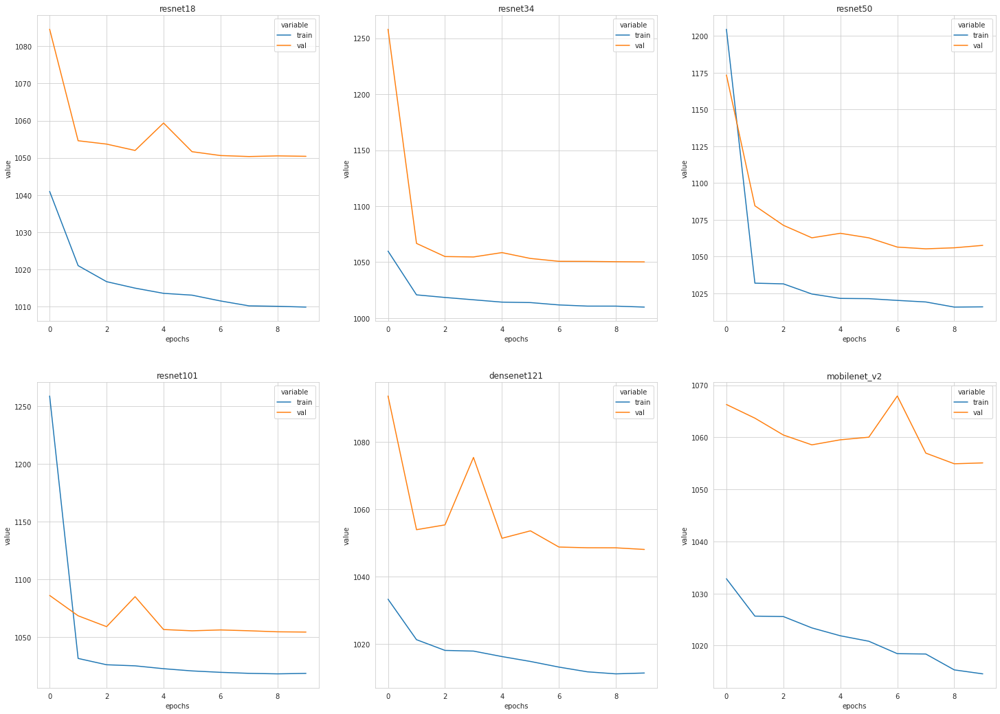

In [ ]:
n_cols = 3
n_rows = len(models_list)//n_cols

fig, axes = plt.subplots(ncols=3, nrows=2,figsize=(25,18))

for i, ax in zip(range(10), axes.flat):
    df_loss = pd.DataFrame.from_dict(out_info[models_list[i]]['loss']).reset_index().melt(id_vars=['index']).rename(columns={"index":"epochs"})
    sns.lineplot(data=df_loss, x = "epochs", y="value", hue="variable",ax=ax).set_title(models_list[i])
plt.show()

In [ ]:
## losses graph
## train/validation 
## Train-Val Loss/Epoch
n_cols = 3
n_rows = len(models_list)//n_cols


fig, ax = plt.subplots(n_rows, n_cols, figsize=(25,18))
ax = ax.ravel()

for i in range(len(n_cols)):
    print(n_cols[i])
    ax[i].set_title('Hist_table ' + num_cols[i])
    ax[i].boxplot(data[num_cols[i]][:100])


plt.show()


In [ ]:
5/2 % 1

0.5

In [ ]:
out_info['resnet18']

In [ ]:
loss_stats = {
    'train': [],
    "val": []
}

for epoch in range(1, params["epochs"] + 1):
    train(train_loader, model, criterion, optimizer, epoch, params)
    validate(valid_loader, model, criterion, epoch, params)

Epoch: 1. Train.      Loss: 3624.966 | MSE: 3624.966: 100%|██████████| 25/25 [00:02<00:00, 10.32it/s]
Epoch: 1. Validation. Loss: 3292.378 | MSE: 3292.378: 100%|██████████| 7/7 [00:00<00:00, 16.80it/s]
Epoch: 2. Train.      Loss: 1980.645 | MSE: 1980.645: 100%|██████████| 25/25 [00:02<00:00, 10.47it/s]
Epoch: 2. Validation. Loss: 1514.406 | MSE: 1514.406: 100%|██████████| 7/7 [00:00<00:00, 13.92it/s]
Epoch: 3. Train.      Loss: 873.636 | MSE: 873.636: 100%|██████████| 25/25 [00:03<00:00,  6.47it/s]
Epoch: 3. Validation. Loss: 526.402 | MSE: 526.402: 100%|██████████| 7/7 [00:00<00:00, 16.31it/s]
Epoch: 4. Train.      Loss: 343.398 | MSE: 343.398: 100%|██████████| 25/25 [00:02<00:00, 10.30it/s]
Epoch: 4. Validation. Loss: 204.785 | MSE: 204.785: 100%|██████████| 7/7 [00:00<00:00, 16.20it/s]
Epoch: 5. Train.      Loss: 154.261 | MSE: 154.261: 100%|██████████| 25/25 [00:02<00:00, 10.29it/s]
Epoch: 5. Validation. Loss: 159.317 | MSE: 159.317: 100%|██████████| 7/7 [00:00<00:00, 15.94it/s]
Ep

Text(0.5, 1.0, 'Train-Val Loss/Epoch')

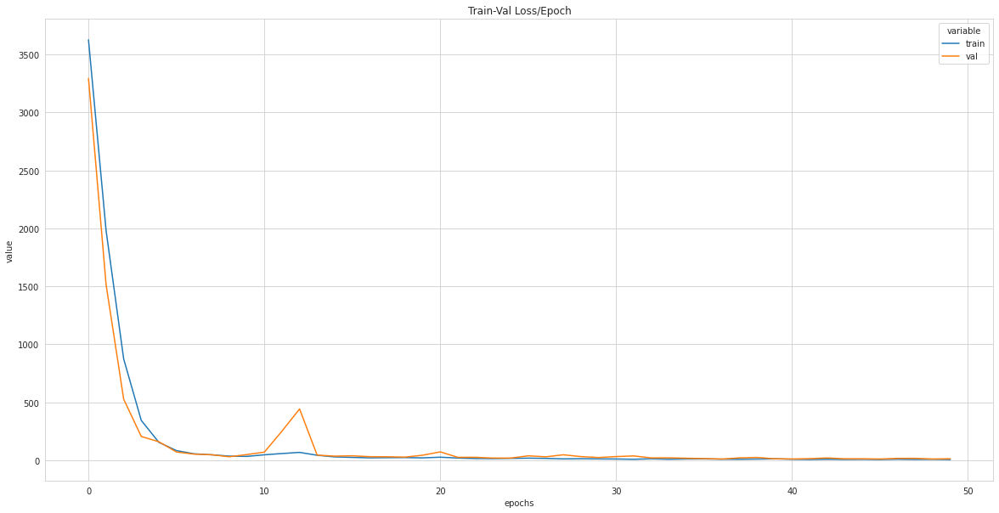

In [ ]:
train_val_loss_df = pd.DataFrame.from_dict(loss_stats).reset_index().melt(id_vars=['index']).rename(columns={"index":"epochs"})

# Plot line charts
fig, axes = plt.subplots(figsize=(20,10))
sns.lineplot(data=train_val_loss_df, x = "epochs", y="value", hue="variable").set_title('Train-Val Loss/Epoch')

In [ ]:
!unzip new_test_car.zip

In [ ]:
class PlatesInferenceDataset(Dataset):
    def __init__(self, images_filepaths, transform=None):
        self.images_filepaths = images_filepaths
        self.transform = transform

    def __len__(self):
        return len(self.images_filepaths)

    def __getitem__(self, idx):
        image_filepath = self.images_filepaths[idx]
        image = cv2.imread(image_filepath)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        sh = image.shape
        if self.transform is not None:
            image = self.transform(image=image)["image"]
        return image, sh, image_filepath


val_transform = A.Compose(
    [   A.Resize(128,128),
        A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225)),
        ToTensorV2(),
    ]
)

In [ ]:
img_ext = ('jpeg','jpg','png','webp','bmp')
fold_path = '/content/car_new_test'
img_inf_path = [os.path.join(fold_path, el) for el in os.listdir(fold_path) if el.endswith(img_ext)]

In [ ]:
test_dataset = PlatesInferenceDataset(images_filepaths=img_inf_path, transform=val_transform)
test_loader = DataLoader(
    test_dataset, batch_size=1, shuffle=False, num_workers=1, pin_memory=True,
)

In [ ]:
x,y=128,128
model = model.eval()
predicted_labels = []
out = []
with torch.no_grad():
  for images in test_loader:
    img = images[0].to(params["device"], non_blocking=True)
    out.append((model(img).reshape(4,2) * torch.cat(((images[1][1])/x, (images[1][0])/y)).to(params["device"]), images[2]))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


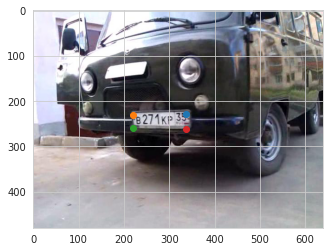

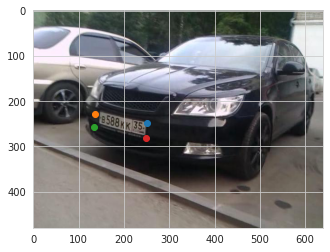

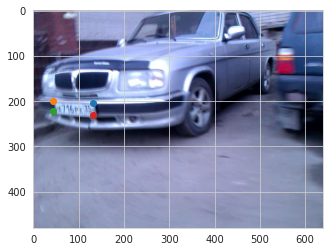

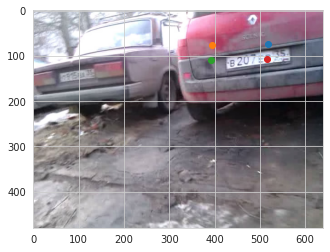

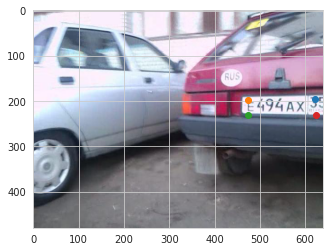

...

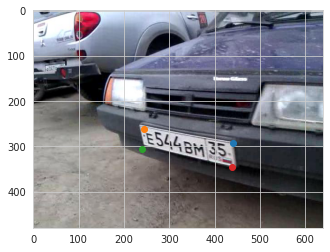

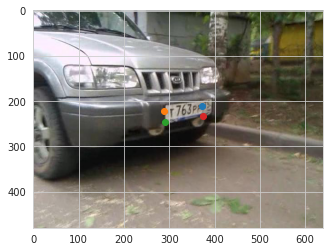

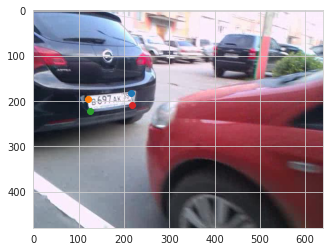

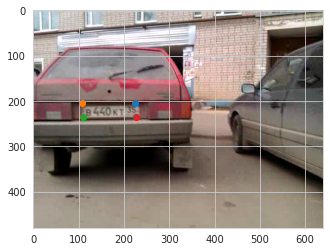

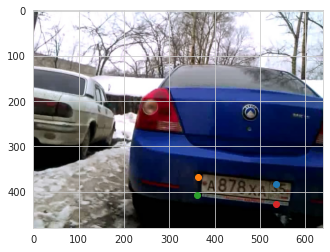

In [ ]:
for el in out:
  fig,ax = plt.subplots()
  img = mpimg.imread(el[1][0])
  imgplot = plt.imshow(img)
  for i in el[0].cpu().detach():
    ax.scatter(i[0],i[1])

In [ ]:
for el in val_dataset:
  data = el
  fig,ax = plt.subplots()
  output = model(data[0].resize(1,3,128,128).cuda())

  imgplot = plt.imshow(data[0].permute(1, 2, 0))
  for i in output.cpu().detach().numpy().reshape(4,2):
    ax.scatter(i[0],i[1])

## Catalyst Sollution

In [ ]:
!pip install -U catalyst

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 446 kB 4.8 MB/s 
     |████████████████████████████████| 125 kB 64.0 MB/s 
     |████████████████████████████████| 143 kB 76.6 MB/s 


In [ ]:
from torch import nn, optim
from catalyst import dl, utils

In [ ]:
loaders = {
    "train": DataLoader(train_dataset, batch_size=params["batch_size"], shuffle=True, num_workers=params["num_workers"], pin_memory=True,),
    "valid": DataLoader(val_dataset, batch_size=params["batch_size"], shuffle=False, num_workers=params["num_workers"], pin_memory=True,)

}

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


In [ ]:
runner = dl.SupervisedRunner(
    input_key="features", output_key="logits", target_key="targets", loss_key="loss"
)

In [ ]:
model = getattr(models, params["model"])(weights=None, num_classes=8,).float()
criterion = MSLELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=params["lr"])

In [ ]:
class MSLELoss(nn.Module):
    def __init__(self):
        super().__init__()
        self.mse = nn.MSELoss()
        
    def forward(self, pred, actual):
        return self.mse(pred,actual)

In [ ]:
runner.train(
    model=model,
    criterion=criterion,
    optimizer=optimizer,
    loaders=loaders,
    num_epochs=100,
    
    logdir="./logs",
    valid_loader="valid",
    valid_metric="loss",
    minimize_valid_metric=True,
    verbose=True,
)

/usr/local/lib/python3.7/dist-packages/torch/utils/data/dataloader.py:566: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  cpuset_checked))


1/100 * Epoch (train):   0%|          | 0/25 [00:00<?, ?it/s]

RuntimeError: ignored

In [ ]:
model = model.to(params["device"])
criterion = nn.MSELoss().to(params["device"])
optimizer = torch.optim.Adam(model.parameters(), lr=params["lr"])
loaders = {
    "train": train_loader,
    "valid": valid_loader,
}